first: clone: https://github.com/AllenInstitute/visual_behavior_glm  
Add to python path

In [1]:
import visual_behavior_glm.src.GLM_params as glm_params
import visual_behavior_glm.src.GLM_analysis_tools as gat
from visual_behavior_glm.src.glm import GLM
import matplotlib.pyplot as plt
import visual_behavior.data_access.loading as loading
import visual_behavior.database as db
import plotly.express as px

import pandas as pd
import numpy as np
import os

from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import seaborn as sns

/home/dougo/Code/AllenSDK/allensdk/brain_observatory/behavior/behavior_ophys_api/behavior_ophys_nwb_api.py:9: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  from pandas.util.testing import assert_frame_equal


In [2]:
%matplotlib notebook
%widescreen

## get results for glm version 4

In [4]:
results_all = gat.retrieve_results(results_type='full')

In [5]:
results_all['glm_version'].unique()
#use v4

array(['3', '4_L2_optimize_by_session', '4_L2_fixed_lambda=1',
       '4_L2_optimize_by_cell', '2', '4_L2_opt_by_cell_tighter_grid',
       '4_L2_opt_by_session_tighter_grid', '5_L2_fixed_lambda=1',
       '5_L2_optimize_by_cell', '5_L2_optimize_by_session'], dtype=object)

In [6]:
rs = gat.retrieve_results(search_dict = {'glm_version': '4_L2_optimize_by_cell'}, results_type='summary')
len(rs)

1365760

### make a new column called 'identifier' that is {OPHYS_EXPERIMENT_ID}_{CELL_SPECIMEN_ID}. This will give each a unique ID

In [7]:
rs['identifier'] = rs['ophys_experiment_id'].astype(str) + '_' +  rs['cell_specimen_id'].astype(str)

In [8]:
rs

,_id,index,dropout,variance_explained,fraction_change_from_full,absolute_change_from_full,cell_specimen_id,ophys_experiment_id,ophys_session_id,behavior_session_id,container_id,project_code,container_workflow_state,experiment_workflow_state,session_name,session_type,equipment_name,date_of_acquisition,isi_experiment_id,specimen_id,sex,age_in_days,full_genotype,reporter_line,driver_line,imaging_depth,targeted_structure,published_at,super_container_id,cre_line,session_tags,failure_tags,exposure_number,model_outputs_available,location,glm_version,entry_time_utc,identifier
0,5f22221a7eeb3a3cbb69c983,0,Full,0.229436,0.000000,0.000000,1017215561,991852008,991639544,991662910,1018028067,VisualBehaviorMultiscope,holding,passed,20191202_479839_6imagesB,OPHYS_6_images_B,MESO.1,2019-12-02 08:27:10.948347,934105391,920877188,M,171.0,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,['Ai93(TITL-GCaMP6f)'],"['Camk2a-tTA', 'Slc17a7-IRES2-Cre']",377,VISl,NaN,920877188,Slc17a7-IRES2-Cre,NaN,NaN,0,1,Slc17a7_VISl_377,4_L2_optimize_by_cell,2020-07-31 17:58:07.596382,991852008_1017215561
1,5f22221a7eeb3a3cbb69c984,1,intercept,0.229937,0.002183,0.000501,1017215561,991852008,991639544,991662910,1018028067,VisualBehaviorMultiscope,holding,passed,20191202_479839_6imagesB,OPHYS_6_images_B,MESO.1,2019-12-02 08:27:10.948347,934105391,920877188,M,171.0,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,['Ai93(TITL-GCaMP6f)'],"['Camk2a-tTA', 'Slc17a7-IRES2-Cre']",377,VISl,NaN,920877188,Slc17a7-IRES2-Cre,NaN,NaN,0,1,Slc17a7_VISl_377,4_L2_optimize_by_cell,2020-07-31 17:58:07.598786,991852008_1017215561
2,5f22221a7eeb3a3cbb69c985,2,time,0.229769,0.001453,0.000333,1017215561,991852008,991639544,991662910,1018028067,VisualBehaviorMultiscope,holding,passed,20191202_479839_6imagesB,OPHYS_6_images_B,MESO.1,2019-12-02 08:27:10.948347,934105391,920877188,M,171.0,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,['Ai93(TITL-GCaMP6f)'],"['Camk2a-tTA', 'Slc17a7-IRES2-Cre']",377,VISl,NaN,920877188,Slc17a7-IRES2-Cre,NaN,NaN,0,1,Slc17a7_VISl_377,4_L2_optimize_by_cell,2020-07-31 17:58:07.600893,991852008_1017215561
3,5f22221a7eeb3a3cbb69c986,3,pre_licks,0.229634,0.000864,0.000198,1017215561,991852008,991639544,991662910,1018028067,VisualBehaviorMultiscope,holding,passed,20191202_479839_6imagesB,OPHYS_6_images_B,MESO.1,2019-12-02 08:27:10.948347,934105391,920877188,M,171.0,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,['Ai93(TITL-GCaMP6f)'],"['Camk2a-tTA', 'Slc17a7-IRES2-Cre']",377,VISl,NaN,920877188,Slc17a7-IRES2-Cre,NaN,NaN,0,1,Slc17a7_VISl_377,4_L2_optimize_by_cell,2020-07-31 17:58:07.603036,991852008_1017215561
4,5f22221a7eeb3a3cbb69c987,4,post_licks,0.227139,-0.010010,-0.002297,1017215561,991852008,991639544,991662910,1018028067,VisualBehaviorMultiscope,holding,passed,20191202_479839_6imagesB,OPHYS_6_images_B,MESO.1,2019-12-02 08:27:10.948347,934105391,920877188,M,171.0,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,['Ai93(TITL-GCaMP6f)'],"['Camk2a-tTA', 'Slc17a7-IRES2-Cre']",377,VISl,NaN,920877188,Slc17a7-IRES2-Cre,NaN,NaN,0,1,Slc17a7_VISl_377,4_L2_optimize_by_cell,2020-07-31 17:58:07.605159,991852008_1017215561
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1365755,5f24621b2ac3d684bf7369e9,27,model_omissions1,0.048034,0.048249,0.002211,962642740,808621034,808340530,808432167,803589437,VisualBehavior,container_qc,passed,20180114_425496_4_imagesB,OPHYS_4_images_B,CAM2P.4,2019-01-14 20:40:17.000000,781470340,772622653,M,111.0,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,['Ai93(TITL-GCaMP6f)'],"['Camk2a-tTA', 'Slc17a7-IRES2-Cre']",175,VISp,NaN,772622653,Slc17a7-IRES2-Cre,NaN,NaN,0,1,Slc17a7_VISp_175,4_L2_optimize_by_cell,2020-07-31 18:25:31.153505,808621034_962642740
1365756,5f24621b2ac3d684bf7369ea,28,model_timing1D,0.048441,0.057133,0.002618,962642740,808621034,808340530,808432167,803589437,VisualBehavior,container_qc,passed,20180114_425496_4_imagesB,O

### pivot the table to get it into a form for clustering

In [6]:
rsp = rs.pivot(index='identifier',columns='dropout',values='fraction_change_from_full').reset_index()
rsp
# rsp = rs.pivot(index=['ophys_experiment_id','cell_specimen_id'],columns='dropout',values='fraction_change_from_full')

dropout,identifier,Full,all-images,beh_model,change,correct_rejects,false_alarms,hits,image0,image1,image2,image3,image4,image5,image6,image7,image_expectation,intercept,misses,model_bias,model_omissions1,model_task0,model_timing1D,omissions,post_lick_bouts,post_licks,pre_lick_bouts,pre_licks,pupil,rewards,running,time,visual
0,1000743008_1003146172,0.0,-0.140389,-0.001503,0.000649,0.010874,0.008735,0.006084,-0.003027,0.000894,0.001913,0.003855,0.003964,-0.001712,-0.027317,0.002895,-0.001125,0.000716,-0.000949,-0.002762,0.000754,0.001279,0.002019,0.000169,0.000047,-0.003575,0.007043,0.016060,-0.069403,0.009835,-0.026210,0.000935,-0.234452
1,1000743008_1003146177,-0.0,0.031472,-0.010406,-0.006038,-0.120232,-0.093710,-0.029602,-0.016474,-0.055626,-0.068242,-0.028669,-0.057503,-0.026265,0.009344,-0.022957,-0.036771,-0.002320,-0.067733,-0.004491,0.000638,-0.002664,-0.001418,-0.241338,-0.048710,-0.066966,-0.242827,-0.270087,-0.117812,-0.231098,-0.030835,-0.002409,-0.088546
2,1000743008_1003146180,0.0,-0.158081,0.002959,0.000689,0.021427,0.016930,0.003956,0.003055,0.003948,-0.004609,-0.008527,0.002539,-0.018968,0.002004,0.004835,0.000325,0.000021,0.004005,-0.000428,0.000557,0.001082,0.001776,0.019329,0.004476,0.005845,0.035919,0.036928,-0.005328,0.035624,0.001423,0.000842,-0.258191
3,1000743008_1003146183,0.0,-0.276624,0.027813,0.000080,0.002911,0.001657,0.001202,0.000854,0.000487,-0.005587,-0.001405,-0.000883,-0.012264,-0.002064,0.000482,-0.002569,-0.004135,0.000588,0.010590,-0.003844,-0.000669,0.007274,-0.002262,-0.002754,0.000713,0.004289,0.003223,-0.091667,0.001301,0.007780,0.001463,-0.373655
4,1000743008_1003146186,0.0,-0.395932,-0.007147,0.000322,0.009145,0.006185,0.001839,-0.000692,-0.003973,0.001734,-0.057583,0.000341,-0.024024,0.000851,0.000275,-0.002277,0.000352,0.002886,-0.002942,0.000013,-0.000626,-0.006288,-0.000053,0.000442,-0.000287,0.004298,0.004190,0.009733,0.010153,0.006419,-0.001985,-0.464464
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43222,995439942_994310000,0.0,-0.531137,0.023576,0.004503,0.061611,0.057912,0.029003,0.003261,0.008303,-0.005995,0.005934,-0.000848,0.005174,-0.077663,0.004336,0.001798,0.003825,0.024656,-0.000907,0.004967,-0.000999,0.006341,0.107008,0.018680,0.020985,0.100658,0.145993,-0.014648,0.068982,0.005242,0.006101,-0.591081
43223,995439942_994310003,0.0,-1.460106,0.117853,0.001589,0.005716,0.001509,0.007758,-0.002338,0.000409,-0.001875,-0.000377,-0.000221,0.002346,-0.028945,0.000691,0.000004,0.015561,0.003566,0.033891,0.003450,0.024784,0.023080,0.010606,0.006317,-0.003386,0.003451,0.004721,-0.007741,0.101305,0.003599,0.016137,-1.464006
43224,995439942_994310018,0.0,-0.557936,0.002745,0.003849,0.048066,0.032185,0.041017,0.017781,-0.005738,0.012714,0.014414,-0.071646,0.013491,0.011297,0.017267,0.005982,0.000047,0.010552,0.002332,-0.014288,-0.000607,-0.001040,0.099897,0.020923,0.031687,0.107409,0.120189,0.018382,0.063471,0.017380,-0.004194,-0.612057
43225,995439942_994310024,0.0,-0.273778,0.013749,0.000563,0.007594,0.004586,0.004196,0.000994,0.002744,-0.001784,0.001255,-0.031503,0.000859,0.001988,-0.003089,-0.000721,-0.000587,0.001694,0.006183,0.002099,0.002030,0.010164,-0.011605,-0.001095,0.003432,0.003779,0.027585,-0.079840,0.012704,-0.030456,0.005305,-0.384110


### merge in the identifier, cre_line, session_type and equipment_name columns

In [7]:
rspm = rsp.merge(rs[['identifier','cre_line','session_type','equipment_name']].drop_duplicates(),left_on='identifier',right_on='identifier',how='inner')
rspm

,identifier,Full,all-images,beh_model,change,correct_rejects,false_alarms,hits,image0,image1,image2,image3,image4,image5,image6,image7,image_expectation,intercept,misses,model_bias,model_omissions1,model_task0,model_timing1D,omissions,post_lick_bouts,post_licks,pre_lick_bouts,pre_licks,pupil,rewards,running,time,visual,cre_line,session_type,equipment_name
0,1000743008_1003146172,0.0,-0.140389,-0.001503,0.000649,0.010874,0.008735,0.006084,-0.003027,0.000894,0.001913,0.003855,0.003964,-0.001712,-0.027317,0.002895,-0.001125,0.000716,-0.000949,-0.002762,0.000754,0.001279,0.002019,0.000169,0.000047,-0.003575,0.007043,0.016060,-0.069403,0.009835,-0.026210,0.000935,-0.234452,Sst-IRES-Cre,OPHYS_1_images_B,CAM2P.3
1,1000743008_1003146177,-0.0,0.031472,-0.010406,-0.006038,-0.120232,-0.093710,-0.029602,-0.016474,-0.055626,-0.068242,-0.028669,-0.057503,-0.026265,0.009344,-0.022957,-0.036771,-0.002320,-0.067733,-0.004491,0.000638,-0.002664,-0.001418,-0.241338,-0.048710,-0.066966,-0.242827,-0.270087,-0.117812,-0.231098,-0.030835,-0.002409,-0.088546,Sst-IRES-Cre,OPHYS_1_images_B,CAM2P.3
2,1000743008_1003146180,0.0,-0.158081,0.002959,0.000689,0.021427,0.016930,0.003956,0.003055,0.003948,-0.004609,-0.008527,0.002539,-0.018968,0.002004,0.004835,0.000325,0.000021,0.004005,-0.000428,0.000557,0.001082,0.001776,0.019329,0.004476,0.005845,0.035919,0.036928,-0.005328,0.035624,0.001423,0.000842,-0.258191,Sst-IRES-Cre,OPHYS_1_images_B,CAM2P.3
3,1000743008_1003146183,0.0,-0.276624,0.027813,0.000080,0.002911,0.001657,0.001202,0.000854,0.000487,-0.005587,-0.001405,-0.000883,-0.012264,-0.002064,0.000482,-0.002569,-0.004135,0.000588,0.010590,-0.003844,-0.000669,0.007274,-0.002262,-0.002754,0.000713,0.004289,0.003223,-0.091667,0.001301,0.007780,0.001463,-0.373655,Sst-IRES-Cre,OPHYS_1_images_B,CAM2P.3
4,1000743008_1003146186,0.0,-0.395932,-0.007147,0.000322,0.009145,0.006185,0.001839,-0.000692,-0.003973,0.001734,-0.057583,0.000341,-0.024024,0.000851,0.000275,-0.002277,0.000352,0.002886,-0.002942,0.000013,-0.000626,-0.006288,-0.000053,0.000442,-0.000287,0.004298,0.004190,0.009733,0.010153,0.006419,-0.001985,-0.464464,Sst-IRES-Cre,OPHYS_1_images_B,CAM2P.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43222,995439942_994310000,0.0,-0.531137,0.023576,0.004503,0.061611,0.057912,0.029003,0.003261,0.008303,-0.005995,0.005934,-0.000848,0.005174,-0.077663,0.004336,0.001798,0.003825,0.024656,-0.000907,0.004967,-0.000999,0.006341,0.107008,0.018680,0.020985,0.100658,0.145993,-0.014648,0.068982,0.005242,0.006101,-0.591081,Sst-IRES-Cre,OPHYS_6_images_A,CAM2P.4
43223,995439942_994310003,0.0,-1.460106,0.117853,0.001589,0.005716,0.001509,0.007758,-0.002338,0.000409,-0.001875,-0.000377,-0.000221,0.002346,-0.028945,0.000691,0.000004,0.015561,0.003566,0.033891,0.003450,0.024784,0.023080,0.010606,0.006317,-0.003386,0.003451,0.004721,-0.007741,0.101305,0.003599,0.016137,-1.464006,Sst-IRES-Cre,OPHYS_6_images_A,CAM2P.4
43224,995439942_994310018,0.0,-0.557936,0.002745,0.003849,0.048066,0.032185,0.041017,0.017781,-0.005738,0.012714,0.014414,-0.071646,0.013491,0.011297,0.017267,0.005982,0.000047,0.010552,0.002332,-0.014288,-0.000607,-0.001040,0.099897,0.020923,0.031687,0.107409,0.120189,0.018382,0.063471,0.017380,-0.004194,-0.612057,Sst-IRES-Cre,OPHYS_6_images_A,CAM2P.4
43225,995439942_994310024,0.0,-0.273778,0.013749,0.000563,0.007594,0.004586,0.004196,0.000994,0.002744,-0.001784,0.001255,-0.031503,0.000859,0.001988,-0.003089,-0.000721,-0.000587,0.001694,0.006183,0.002099,0.002030,0.010164,-0.011605,-0.001095,0.003432,0.003779,0.027585,-0.079840,0.012704,-0.030456,0.005305,-0.384110,Sst-IRES-Cre,OPHYS_6_images_A,CAM2P.4


### add a column for session ID (1, 3, 4, or 6)

In [8]:
def map_session_types(session_type):
    session_id = session_type[6:7]
    return session_id
rspm['session_id'] = rspm['session_type'].map(lambda st:map_session_types(st))
rspm['session_id'].unique()

array(['1', '3', '4', '6'], dtype=object)

### save feature matrix to disk

In [9]:
save = False
if save:
    rspm.to_csv('/allen/programs/braintv/workgroups/nc-ophys/visual_behavior/ophys_glm/fraction_change_var_explained_v_4_L2_fixed_lambda=1_2020.08.03.csv', index=False)

### get the column names to use for clustering

In [10]:
cols_for_clustering = [col for col in rspm.columns if col not in ['identifier','cre_line','session_type','equipment_name', 'session_id']]
cols_for_clustering

['Full',
 'all-images',
 'beh_model',
 'change',
 'correct_rejects',
 'false_alarms',
 'hits',
 'image0',
 'image1',
 'image2',
 'image3',
 'image4',
 'image5',
 'image6',
 'image7',
 'image_expectation',
 'intercept',
 'misses',
 'model_bias',
 'model_omissions1',
 'model_task0',
 'model_timing1D',
 'omissions',
 'post_lick_bouts',
 'post_licks',
 'pre_lick_bouts',
 'pre_licks',
 'pupil',
 'rewards',
 'running',
 'time',
 'visual']

### do k-means on the full feature matrix

In [11]:
# create kmeans object
kmeans = KMeans(n_clusters=4)

In [12]:
# fit kmeans object to data
kmeans.fit(rspm[cols_for_clustering])

KMeans(n_clusters=4)

In [13]:
rspm['k-means_cluster_id'] = kmeans.fit_predict(rspm[cols_for_clustering])

#### it is assigning almost all cells to a single cluster - not useful!

In [14]:
rspm['k-means_cluster_id'].value_counts()

0    43223
3        2
2        1
1        1
Name: k-means_cluster_id, dtype: int64

### make a tsne plot

In [15]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)

In [16]:
tsne_results = tsne.fit_transform(rspm[cols_for_clustering])

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 43227 samples in 0.172s...
[t-SNE] Computed neighbors for 43227 samples in 26.326s...
[t-SNE] Computed conditional probabilities for sample 1000 / 43227
[t-SNE] Computed conditional probabilities for sample 2000 / 43227
[t-SNE] Computed conditional probabilities for sample 3000 / 43227
[t-SNE] Computed conditional probabilities for sample 4000 / 43227
[t-SNE] Computed conditional probabilities for sample 5000 / 43227
[t-SNE] Computed conditional probabilities for sample 6000 / 43227
[t-SNE] Computed conditional probabilities for sample 7000 / 43227
[t-SNE] Computed conditional probabilities for sample 8000 / 43227
[t-SNE] Computed conditional probabilities for sample 9000 / 43227
[t-SNE] Computed conditional probabilities for sample 10000 / 43227
[t-SNE] Computed conditional probabilities for sample 11000 / 43227
[t-SNE] Computed conditional probabilities for sample 12000 / 43227
[t-SNE] Computed conditional probabilities for s

#### assign tsne reults to new columns

In [17]:
rspm['tsne-2d-one'] = tsne_results[:,0]
rspm['tsne-2d-two'] = tsne_results[:,1]

In [18]:
rspm['session_type'].unique()

array(['OPHYS_1_images_B', 'OPHYS_3_images_B', 'OPHYS_4_images_A',
       'OPHYS_6_images_A', 'OPHYS_1_images_A', 'OPHYS_3_images_A',
       'OPHYS_4_images_B', 'OPHYS_6_images_B'], dtype=object)

### make a histogram of the omission dropout values

<IPython.core.display.Javascript object>


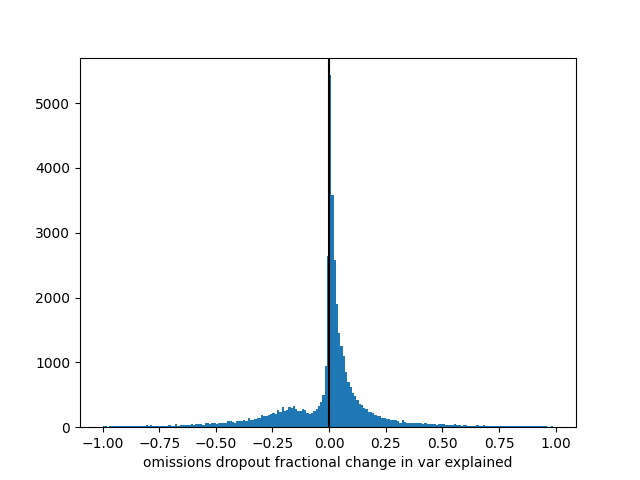

Text(0.5, 0, 'omissions dropout fractional change in var explained')

In [19]:
fig,ax=plt.subplots()
ax.hist(rspm['omissions'],bins=np.arange(-1,1,0.01))
ax.axvline(0,color='black')
ax.set_xlabel('omissions dropout fractional change in var explained')

### make a new column that identifies cells as 'modulated' by running or omissions (the threshold is up for debate!)

In [20]:
def is_modulated(v, threshold=0):
    return v < threshold
rspm['omission_modulated'] = rspm['omissions'].map(lambda v:is_modulated(v, threshold=0))
rspm['running_modulated'] = rspm['running'].map(lambda v:is_modulated(v, threshold=0))

### plot the tsne results, coloring dots in different ways
It looks like they cluster almost perfectly by omission modulation!

<IPython.core.display.Javascript object>


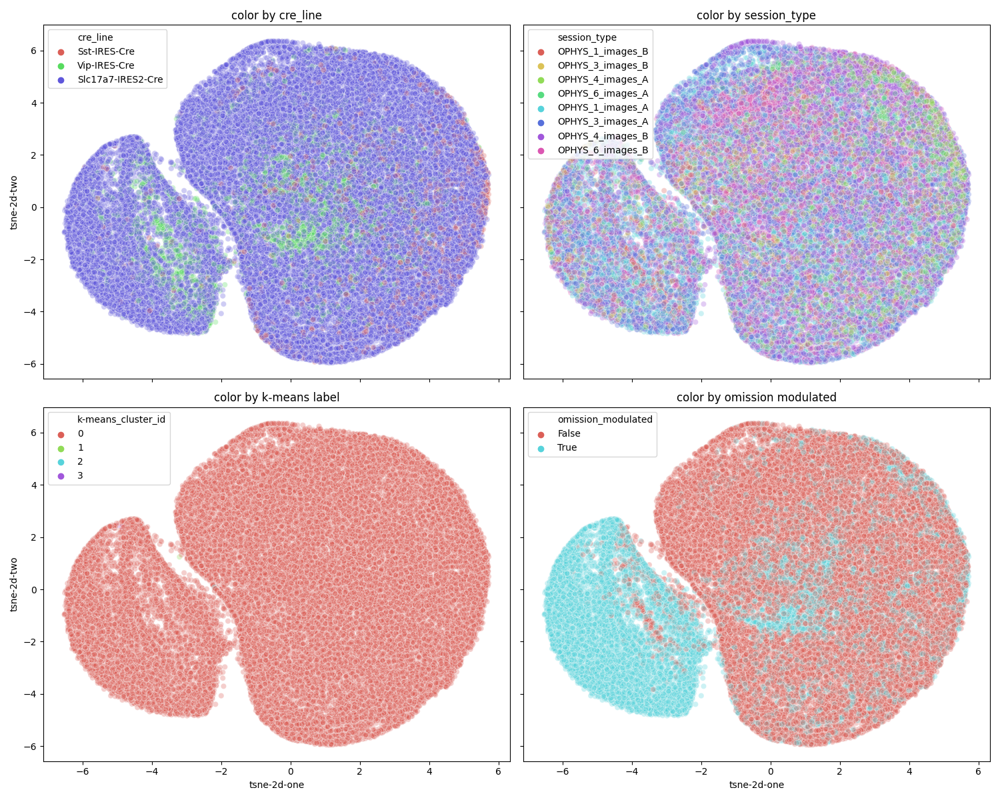

In [21]:

fig,ax=plt.subplots(2,2,figsize=(15,12),sharey=True,sharex=True)
sns.scatterplot(
    x="tsne-2d-one", 
    y="tsne-2d-two",
    hue="cre_line",
    palette=sns.color_palette("hls", 3),
    data=rspm,
    legend="full",
    alpha=0.3,
    ax=ax[0,0]
)
sns.scatterplot(
    x="tsne-2d-one", 
    y="tsne-2d-two",
    hue="session_type",
    palette=sns.color_palette("hls", 8),
    data=rspm,
    legend="full",
    alpha=0.3,
    ax=ax[0,1]
)
sns.scatterplot(
    x="tsne-2d-one", 
    y="tsne-2d-two",
    hue="k-means_cluster_id",
    palette=sns.color_palette("hls", 4),
    data=rspm,
    legend="full",
    alpha=0.3,
    ax=ax[1,0]
)
sns.scatterplot(
    x="tsne-2d-one", 
    y="tsne-2d-two",
    hue='omission_modulated',
    palette=sns.color_palette("hls", 2),
    data=rspm,
    legend="full",
    alpha=0.3,
    ax=ax[1,1]
)
fig.tight_layout()
for ii,hue in enumerate(['cre_line','session_type','k-means label', 'omission modulated']):
    ax.flatten()[ii].set_title('color by {}'.format(hue))
fig.tight_layout()

### plot tsne again, grouped by cre-line

<IPython.core.display.Javascript object>


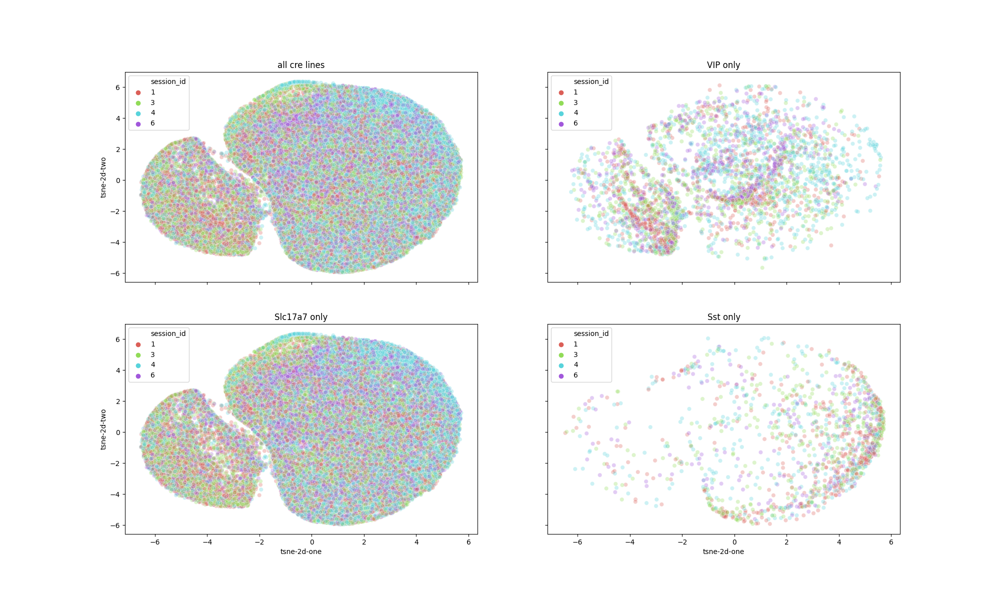

Text(0.5, 1.0, 'Sst only')

In [22]:
fig,ax=plt.subplots(2,2,figsize=(20,12),sharey=True,sharex=True)
sns.scatterplot(
    x="tsne-2d-one", 
    y="tsne-2d-two",
    hue="session_id",
    palette=sns.color_palette("hls", 4),
    data=rspm, #.query('cre_line=="Vip-IRES-Cre"'),
    legend='full',
    alpha=0.3,
    ax=ax[0,0]
)
ax[0,0].set_title('all cre lines')

sns.scatterplot(
    x="tsne-2d-one", 
    y="tsne-2d-two",
    hue="session_id",
    palette=sns.color_palette("hls", 4),
    data=rspm.query('cre_line=="Vip-IRES-Cre"'),
    legend='full',
    alpha=0.3,
    ax=ax[0,1]
)
ax[0,1].set_title('VIP only')

sns.scatterplot(
    x="tsne-2d-one", 
    y="tsne-2d-two",
    hue="session_id",
    palette=sns.color_palette("hls", 4),
    data=rspm.query('cre_line=="Slc17a7-IRES2-Cre"'),
    legend='full',
    alpha=0.3,
    ax=ax[1,0]
)
ax[1,0].set_title('Slc17a7 only')

sns.scatterplot(
    x="tsne-2d-one", 
    y="tsne-2d-two",
    hue="session_id",
    palette=sns.color_palette("hls", 4),
    data=rspm.query('cre_line=="Sst-IRES-Cre"'),
    legend='full',
    alpha=0.3,
    ax=ax[1,1]
)
ax[1,1].set_title('Sst only')

### plot tsne again, colored continuously by the omissions dropout

<IPython.core.display.Javascript object>


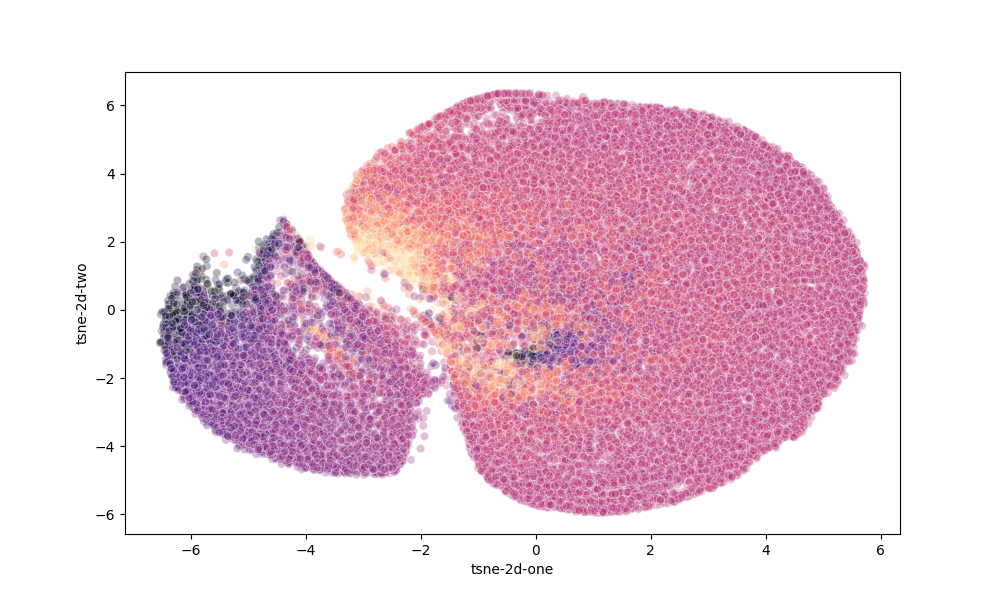

In [23]:
fig,ax=plt.subplots(1,1,figsize=(10,6),sharey=True,sharex=True)
sns.scatterplot(
    x="tsne-2d-one", 
    y="tsne-2d-two",
    hue='omissions',
    palette='magma',
    data=rspm.query('omissions>-1 and omissions<1'),
    legend=False,
    alpha=0.3,
    ax=ax
)


### do PCA
a huge amount of variance is in just the first few PCs!

In [67]:
rspm

,identifier,Full,all-images,beh_model,change,correct_rejects,false_alarms,hits,image0,image1,image2,image3,image4,image5,image6,image7,image_expectation,intercept,misses,model_bias,model_omissions1,model_task0,model_timing1D,omissions,post_lick_bouts,post_licks,pre_lick_bouts,pre_licks,pupil,rewards,running,time,visual,cre_line,session_type,equipment_name,session_id,k-means_cluster_id,tsne-2d-one,tsne-2d-two,omission_modulated,running_modulated,pc1,pc2,pc3,k-means_on_PCs,k-means_on_tSNE,hc,umap_3d_embedding_0,umap_3d_embedding_1,umap_3d_embedding_2,umap_2d_embedding_0,umap_2d_embedding_1,k-means_on_2d_umap,k-means_on_3d_umap
0,1000743008_1003146172,0.0,-0.140389,-0.001503,0.000649,0.010874,0.008735,0.006084,-0.003027,0.000894,0.001913,0.003855,0.003964,-0.001712,-0.027317,0.002895,-0.001125,0.000716,-0.000949,-0.002762,0.000754,0.001279,0.002019,0.000169,0.000047,-0.003575,0.007043,0.016060,-0.069403,0.009835,-0.026210,0.000935,-0.234452,Sst-IRES-Cre,OPHYS_1_images_B,CAM2P.3,1,0,4.307938,3.570804,False,True,-0.097600,-0.182322,-0.201880,0,0,0,8.659638,10.386257,8.986835,11.277253,11.124822,1,2
1,1000743008_1003146177,-0.0,0.031472,-0.010406,-0.006038,-0.120232,-0.093710,-0.029602,-0.016474,-0.055626,-0.068242,-0.028669,-0.057503,-0.026265,0.009344,-0.022957,-0.036771,-0.002320,-0.067733,-0.004491,0.000638,-0.002664,-0.001418,-0.241338,-0.048710,-0.066966,-0.242827,-0.270087,-0.117812,-0.231098,-0.030835,-0.002409,-0.088546,Sst-IRES-Cre,OPHYS_1_images_B,CAM2P.3,1,0,-4.641715,-2.584095,True,True,-0.410407,-0.591185,-0.060642,0,1,0,-1.542038,5.329230,8.712886,-2.572323,5.891275,0,1
2,1000743008_1003146180,0.0,-0.158081,0.002959,0.000689,0.021427,0.016930,0.003956,0.003055,0.003948,-0.004609,-0.008527,0.002539,-0.018968,0.002004,0.004835,0.000325,0.000021,0.004005,-0.000428,0.000557,0.001082,0.001776,0.019329,0.004476,0.005845,0.035919,0.036928,-0.005328,0.035624,0.001423,0.000842,-0.258191,Sst-IRES-Cre,OPHYS_1_images_B,CAM2P.3,1,0,4.696145,3.372334,False,False,-0.093327,-0.126134,-0.205373,0,0,0,9.173984,10.112137,9.203481,11.577892,11.022003,1,2
3,1000743008_1003146183,0.0,-0.276624,0.027813,0.000080,0.002911,0.001657,0.001202,0.000854,0.000487,-0.005587,-0.001405,-0.000883,-0.012264,-0.002064,0.000482,-0.002569,-0.004135,0.000588,0.010590,-0.003844,-0.000669,0.007274,-0.002262,-0.002754,0.000713,0.004289,0.003223,-0.091667,0.001301,0.007780,0.001463,-0.373655,Sst-IRES-Cre,OPHYS_1_images_B,CAM2P.3,1,0,4.462588,1.066535,True,False,-0.063262,-0.044523,-0.075712,0,0,0,8.816609,7.882723,9.660962,12.340587,8.538951,1,2
4,1000743008_1003146186,0.0,-0.395932,-0.007147,0.000322,0.009145,0.006185,0.001839,-0.000692,-0.003973,0.001734,-0.057583,0.000341,-0.024024,0.000851,0.000275,-0.002277,0.000352,0.002886,-0.002942,0.000013,-0.000626,-0.006288,-0.000053,0.000442,-0.000287,0.004298,0.004190,0.009733,0.010153,0.006419,-0.001985,-0.464464,Sst-IRES-Cre,OPHYS_1_images_B,CAM2P.3,1,0,5.627115,-0.415000,True,False,-0.111537,0.096356,-0.002110,0,0,0,9.503942,6.320076,10.316698,13.563780,6.878680,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43222,995439942_994310000,0.0,-0.531137,0.023576,0.004503,0.061611,0.057912,0.029003,0.003261,0.008303,-0.005995,0.005934,-0.000848,0.005174,-0.077663,0.004336,0.001798,0.003825,0.024656,-0.000907,0.004967,-0.000999,0.006341,0.107008,0.018680,0.020985,0.100658,0.145993,-0.014648,0.068982,0.005242,0.006101,-0.591081,Sst-IRES-Cre,OPHYS_6_images_A,CAM2P.4,6,0,3.570788,-1.431543,False,False,0.053261,0.322973,-0.011037,0,0,0,10.110785,5.097785,8.920865,12.582057,5.186720,1,0
43223,995439942_994310003,0.0,-1.460106,0.117853,0.001589,0.005716,0.001509,0.007758,-0.002338,0.000409,-0.001875,-0.000377,-0.000221,0.002346,-0.028945,0.000691,0.000004,0.015561,0.003566,0.033891,0.003450,0.024784,0.023080,0.010606,0.006317,-0.003386,0.003451,0.

In [68]:
cols_for_clustering

['Full',
 'all-images',
 'beh_model',
 'change',
 'correct_rejects',
 'false_alarms',
 'hits',
 'image0',
 'image1',
 'image2',
 'image3',
 'image4',
 'image5',
 'image6',
 'image7',
 'image_expectation',
 'intercept',
 'misses',
 'model_bias',
 'model_omissions1',
 'model_task0',
 'model_timing1D',
 'omissions',
 'post_lick_bouts',
 'post_licks',
 'pre_lick_bouts',
 'pre_licks',
 'pupil',
 'rewards',
 'running',
 'time',
 'visual']

In [52]:
np.shape(rspm[cols_for_clustering].values)

(43227, 32)

In [53]:

pca = PCA(n_components=len(cols_for_clustering))
pca_result = pca.fit_transform(rspm[cols_for_clustering].values)
rspm['pc1'] = pca_result[:,0]
rspm['pc2'] = pca_result[:,1] 
rspm['pc3'] = pca_result[:,2]
print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))
    

Explained variation per principal component: [4.52448572e-01 2.66072027e-01 1.26401269e-01 6.65491930e-02
 2.74613762e-02 1.69994428e-02 1.08397478e-02 8.18528489e-03
 5.18590027e-03 4.27164073e-03 3.66490145e-03 3.15946630e-03
 2.01182369e-03 1.56601443e-03 1.47368065e-03 8.11330669e-04
 6.44374056e-04 4.31229321e-04 4.05798912e-04 2.36280097e-04
 2.24664472e-04 1.99448169e-04 1.78448574e-04 1.37522583e-04
 1.28277526e-04 8.79065856e-05 7.39690843e-05 5.60658530e-05
 4.96693583e-05 4.23016544e-05 2.37293226e-06 1.94317935e-33]


In [69]:
dir(pca)

['__abstractmethods__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_abc_impl',
 '_check_n_features',
 '_fit',
 '_fit_full',
 '_fit_svd_solver',
 '_fit_truncated',
 '_get_param_names',
 '_get_tags',
 '_more_tags',
 '_repr_html_',
 '_repr_html_inner',
 '_repr_mimebundle_',
 '_validate_data',
 'components_',
 'copy',
 'explained_variance_',
 'explained_variance_ratio_',
 'fit',
 'fit_transform',
 'get_covariance',
 'get_params',
 'get_precision',
 'inverse_transform',
 'iterated_power',
 'mean_',
 'n_components',
 'n_components_',
 'n_features_',
 'n_features_in_',
 'n_samples_',
 'noise_variance_',
 'random_state',
 'score',
 'scor

In [70]:
np.shape(pca.components_)

(32, 32)

<IPython.core.display.Javascript object>


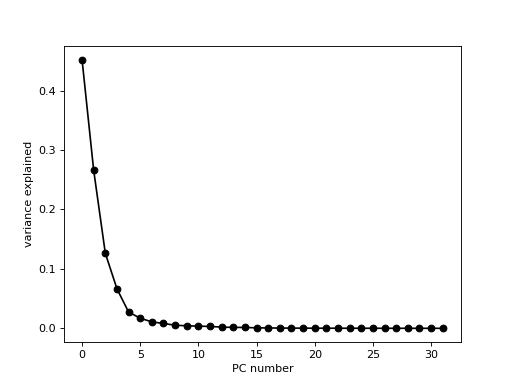

Text(0, 0.5, 'variance explained')

In [55]:
fig,ax=plt.subplots()
ax.plot(
    np.arange(len(cols_for_clustering)),
    pca.explained_variance_ratio_,
    'o-k'
)
ax.set_xlabel('PC number')
ax.set_ylabel('variance explained')

In [56]:
np.shape(pca_result)

(43227, 32)

In [59]:
np.shape(pca_result[0,:])

(32,)

### examine the PC components individually

followups
* remove redundant features before performing PCA
* Only plot PC dimensions that explain a reasonable amount of variance (each PC will sum to one, so low variance PCs will be misleading).

In [73]:
pca.components_[:,0].sum()

1.0

In [79]:
pca.components_[:,0]

array([-1.25070961e-21, -3.97296961e-21, -9.26012610e-21,  6.58110242e-21,
       -7.17052624e-22,  6.11326943e-22, -3.01492084e-20, -3.67081731e-20,
       -1.57623629e-20, -6.87651707e-21, -4.50417141e-20, -2.85389064e-21,
        2.42029283e-20,  7.70092997e-20, -3.95501876e-21, -7.45907271e-20,
        5.75734548e-20,  2.45807071e-20, -1.81373966e-19,  9.83077930e-20,
        1.64124415e-19,  1.28954795e-19, -6.81809781e-20,  7.88134179e-20,
       -2.88022575e-19, -1.33709599e-18, -8.26605569e-19, -1.95021161e-19,
        1.10206569e-18,  8.26543464e-19,  4.80785486e-19,  1.00000000e+00])

<IPython.core.display.Javascript object>


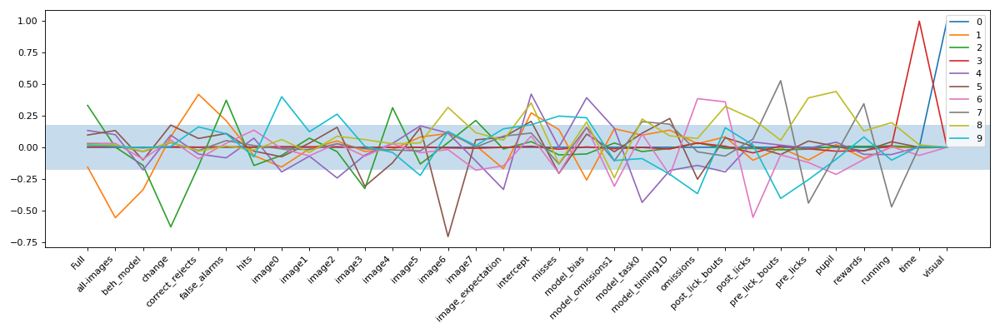

In [85]:
fig,ax=plt.subplots(figsize=(15,5))
N_PCs = 10
for PC in range(N_PCs):
    ax.plot(
        pca.components_[:,PC]
    )
ax.legend(np.arange(N_PCs))
ax.axhspan(1/np.sqrt(32),-1/np.sqrt(32),zorder=-np.inf,alpha=0.25)
ax.set_xticks(np.arange(32))
ax.set_xticklabels(cols_for_clustering,rotation=45,ha='right')
fig.tight_layout()

### Can I do k-means in PCA space?
No, it is still assigning nearly all cells to a single cluster

In [26]:
pc_cols = ['pc1','pc2','pc3']
kmeans = KMeans(n_clusters=3)
kmeans.fit(rspm[pc_cols])
rspm['k-means_on_PCs'] = kmeans.fit_predict(rspm[pc_cols])
rspm['k-means_on_PCs'].value_counts()

0    43225
2        1
1        1
Name: k-means_on_PCs, dtype: int64

### plot PCA results, colored by cre-line

<IPython.core.display.Javascript object>


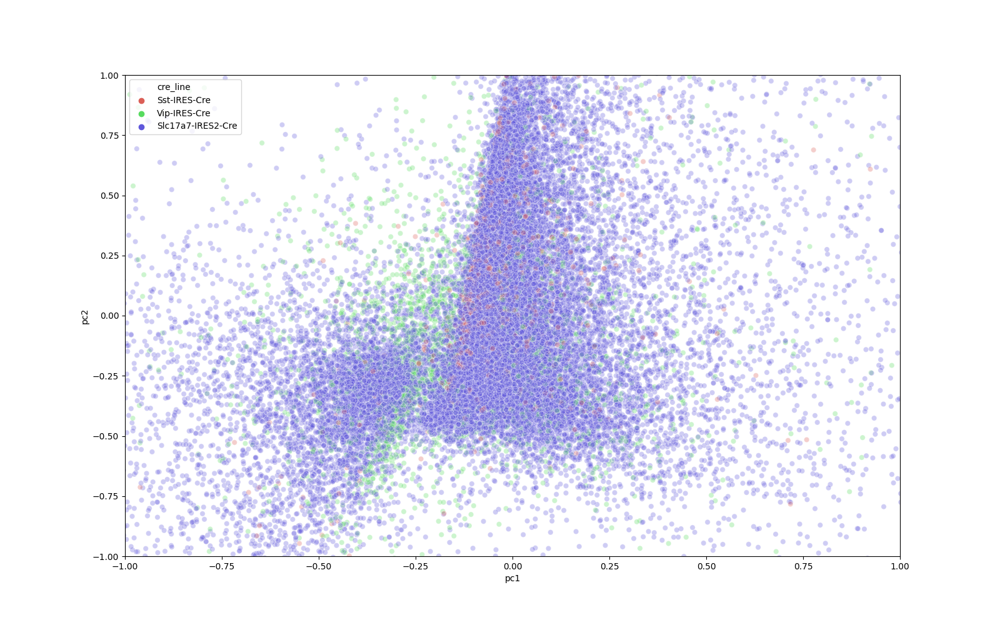

(-1.0, 1.0)

In [27]:
fig,ax = plt.subplots(figsize=(16,10))
sns.scatterplot(
    x="pc1", y="pc2",
    hue="cre_line",
    palette=sns.color_palette("hls", 3),
    data=rspm,
    legend="full",
    alpha=0.3,
    ax=ax
)

ax.set_xlim(-1,1)
ax.set_ylim(-1,1)

In [28]:
sample_size=1000
dfs = []
for cre_line in rspm['cre_line'].unique():
    dfs.append(rspm.query('cre_line == @cre_line').sample(sample_size, random_state=0))
data_sample = pd.concat(dfs)
data_sample

,identifier,Full,all-images,beh_model,change,correct_rejects,false_alarms,hits,image0,image1,image2,image3,image4,image5,image6,image7,image_expectation,intercept,misses,model_bias,model_omissions1,model_task0,model_timing1D,omissions,post_lick_bouts,post_licks,pre_lick_bouts,pre_licks,pupil,rewards,running,time,visual,cre_line,session_type,equipment_name,session_id,k-means_cluster_id,tsne-2d-one,tsne-2d-two,omission_modulated,running_modulated,pc1,pc2,pc3,k-means_on_PCs
11894,866518320_1017154525,-0.0,4.555885,-0.136390,-0.058962,-1.822289,-5.553651e-01,-0.842102,-0.511389,-0.816772,-0.088962,-0.055272,-0.125720,-0.370497,0.212552,0.520585,-0.124919,0.044717,-1.543585,-0.073105,0.000220,0.060292,-0.099242,-3.765036,-0.226366,0.467886,-2.607666,-1.935303,-2.192263,-2.536465,-1.097044,0.024875,2.191581,Sst-IRES-Cre,OPHYS_1_images_A,MESO.1,1,0,-4.870420,2.230760,True,True,-3.209277,-6.644700,0.073867,0
31751,960960480_1007031649,0.0,-0.930867,0.038345,0.000499,0.016764,-8.147871e-03,0.006205,-0.006785,0.003086,0.001395,-0.000263,-0.000728,0.001255,-0.030448,-0.019804,-0.000172,0.005968,0.026344,0.026563,-0.030652,-0.021334,0.027588,0.044205,0.005967,0.030877,0.023615,0.018765,-0.032012,0.046163,-0.024542,-0.030017,-0.914518,Sst-IRES-Cre,OPHYS_6_images_A,CAM2P.5,6,0,0.938136,-4.644485,False,True,0.036688,0.627460,0.365895,0
37785,978296110_1018079696,0.0,-0.027599,-0.001296,0.000128,0.005208,2.127876e-03,0.003747,-0.001767,-0.005598,-0.000585,0.000870,0.000618,0.001827,0.000630,-0.006402,0.000381,0.000601,0.000917,-0.001926,0.000244,-0.000678,-0.000815,0.008055,-0.023770,-0.047688,-0.009370,-0.038955,0.006253,0.005021,-0.035361,-0.000707,-0.040767,Sst-IRES-Cre,OPHYS_4_images_B,MESO.1,4,0,1.140991,6.072178,False,True,-0.164002,-0.356043,-0.324096,0
10888,853363753_1028819224,0.0,-0.451794,0.001520,0.000297,0.005872,-1.769497e-12,0.000557,0.000761,0.001450,-0.054848,-0.000454,-0.025315,-0.009278,0.001255,-0.003628,-0.000640,-0.005605,0.001745,0.001914,0.002065,0.002133,-0.004228,-0.000248,0.000581,0.001443,0.010491,0.011464,-0.042199,0.003066,-0.024923,0.000308,-0.528899,Sst-IRES-Cre,OPHYS_4_images_B,MESO.1,4,0,5.168228,-1.288473,True,True,-0.079820,0.151211,0.038772,0
30764,956941841_1028821154,0.0,-0.301967,0.010075,0.000385,0.009948,1.879844e-02,0.001596,-0.003783,-0.054795,-0.018909,-0.007288,-0.001602,0.002125,0.001153,-0.001112,0.001701,0.002068,-0.000286,0.001079,0.006372,0.005774,0.005804,0.011476,0.010210,0.005375,0.024278,0.024201,-0.101345,0.008978,-0.049966,0.003145,-0.393568,Sst-IRES-Cre,OPHYS_3_images_A,MESO.1,3,0,4.223166,0.762480,False,True,-0.051987,-0.001184,-0.090412,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38627,989213062_1018074883,-0.0,-0.230452,-0.046018,-0.001948,-0.041122,-2.233581e-01,-0.047426,-0.006757,-0.043267,-0.002538,-0.011291,-0.020565,-0.068184,0.002096,-0.065786,-0.032867,-0.017790,-0.041233,0.015203,0.013299,-0.025750,-0.021018,-0.179641,-0.029306,-0.015931,-0.157065,-0.187656,-0.081408,-0.084709,0.288977,-0.025345,-0.369504,Slc17a7-IRES2-Cre,OPHYS_3_images_A,MESO.1,3,0,-4.264534,-3.113028,True,False,-0.291521,-0.236511,0.176093,0
937,792813858_962619738,0.0,-0.683959,0.055992,0.001246,0.000660,2.749526e-03,-0.001114,-0.000696,-0.022192,0.000270,0.002903,0.000299,-0.001321,0.000178,-0.001035,0.001205,0.003857,-0.000570,0.028945,0.003441,0.001174,0.013550,0.008262,-0.000050,-0.005115,0.009002,0.004051,0.008672,-0.007667,-0.000146,0.009350,-0.678786,Slc17a7-IRES2-Cre,OPHYS_1_images_A,CAM2P.4,1,0,3.524376,-3.017242,False,True,-0.047017,0.368003,0.178570,0
40418,992084635_1017243860,0.0,-0.369747,0.034291,0.002467,0.086151,6.000838e-02,0.026469,0.017305,-0.048316,0.030748,0.017746,0.004811,-0.124346,0.007085,0.002200,0.001321,0.023757,0.064739,0.007280,0.012169,0.002364,-0.000449,0.134889,0.024674,0.069367,0.010726,0.158362,0.159922,0.142541,-0.061854,0

### make a 3D plotly plot of the PCA results (1000 cells from each cre line)

In [29]:
query_string = '''pc1>-1 and pc1 < 1 and pc2>-1 and pc2 < 1 and pc3>-1 and pc3 < 1'''
fig = px.scatter_3d(
    data_sample.query(query_string), 
    x='pc1', 
    y='pc2', 
    z='pc3',
    color='cre_line',
)
fig.update_traces(
    marker=dict(
        size=3,
        opacity=0.25
    )
)
fig.update_layout(
    margin=dict(l=30, r=30, t=10, b=10),
    width=1200,
    height=1000,
)
fig.write_html("/home/dougo/code/dougollerenshaw.github.io/figures_to_share/2020.08.04_PCA_on_GLM.html")
fig.show()

### do kmeans clustring on the tsne space
It kinda works

In [30]:
kmeans = KMeans(n_clusters=2)
kmeans.fit(rspm[pc_cols])
tsne_cols = ['tsne-2d-one','tsne-2d-two']
rspm['k-means_on_tSNE'] = kmeans.fit_predict(rspm[tsne_cols])
rspm['k-means_on_tSNE'].value_counts()

0    22502
1    20725
Name: k-means_on_tSNE, dtype: int64

<IPython.core.display.Javascript object>


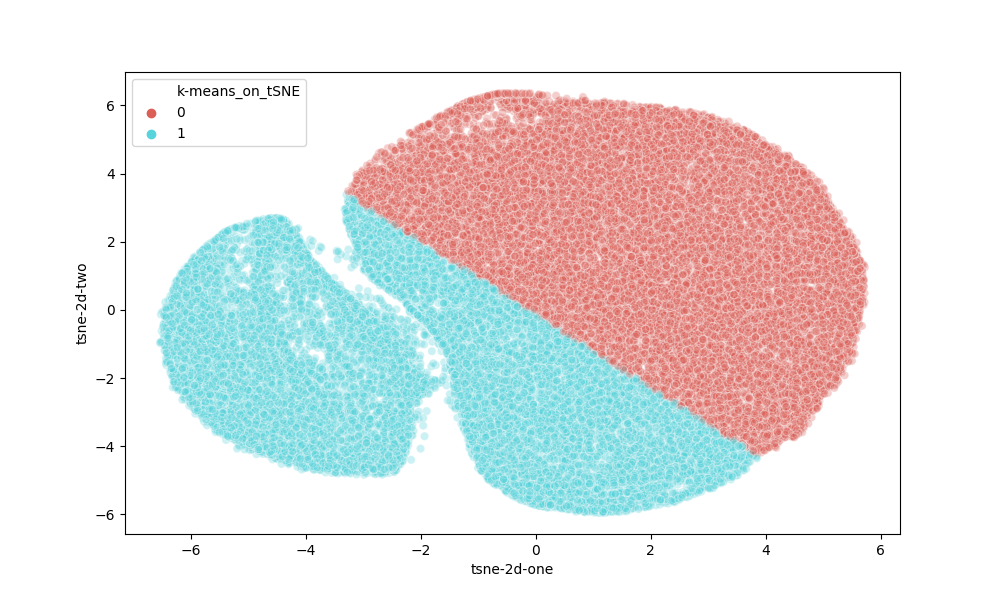

In [31]:
fig,ax=plt.subplots(1,1,figsize=(10,6),sharey=True,sharex=True)
sns.scatterplot(
    x="tsne-2d-one", 
    y="tsne-2d-two",
    hue='k-means_on_tSNE',
    palette=sns.color_palette("hls", 2),
    data=rspm,
    legend='full',
    alpha=0.3,
    ax=ax,
)

### try agglomerative clustering?
It's also assigning to a single cluster

In [32]:
# import hierarchical clustering libraries
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering

In [33]:

# create clusters
hc = AgglomerativeClustering(n_clusters=4, affinity = 'euclidean', linkage = 'ward')
# save clusters for chart
y_hc = hc.fit_predict(rspm[cols_for_clustering])

In [34]:
rspm['hc'] = y_hc
rspm['hc'].value_counts()

[autoreload of allensdk.core.typing failed: Traceback (most recent call last):
  File "/home/dougo/.conda/envs/visual_behavior/lib/python3.8/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/home/dougo/.conda/envs/visual_behavior/lib/python3.8/site-packages/IPython/extensions/autoreload.py", line 394, in superreload
    module = reload(module)
  File "/home/dougo/.conda/envs/visual_behavior/lib/python3.8/imp.py", line 314, in reload
    return importlib.reload(module)
  File "/home/dougo/.conda/envs/visual_behavior/lib/python3.8/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 604, in _exec
  File "<frozen importlib._bootstrap_external>", line 783, in exec_module
  File "<frozen importlib._bootstrap>", line 219, in _call_with_frames_removed
  File "/home/dougo/Code/AllenSDK/allensdk/core/typing.py", line 1, in <module>
    from typing import

0    43223
1        2
3        1
2        1
Name: hc, dtype: int64

# UMAP

## try it out!

### perform both a 2d and 3d embedding

In [35]:
import umap

reducer_2d = umap.UMAP(n_components=2)
reducer_3d = umap.UMAP(n_components=3)

embedding_2d = reducer_2d.fit_transform(rspm[cols_for_clustering])
embedding_3d = reducer_3d.fit_transform(rspm[cols_for_clustering])
embedding_3d.shape

/home/dougo/.conda/envs/visual_behavior/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:355: NumbaWarning:

The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.



(43227, 3)

### assign umap results to new columns

In [36]:
rspm['umap_3d_embedding_0'] = embedding_3d[:, 0]
rspm['umap_3d_embedding_1'] = embedding_3d[:, 1]
rspm['umap_3d_embedding_2'] = embedding_3d[:, 2]

rspm['umap_2d_embedding_0'] = embedding_2d[:, 0]
rspm['umap_2d_embedding_1'] = embedding_2d[:, 1]

### do kmeans on the 2d embedding
only two clusters since the 2d umap gives two clear clusters
k-means seems to identify them perfectly!

In [43]:
kmeans = KMeans(n_clusters=2)
umap_2d_cols = ['umap_2d_embedding_0','umap_2d_embedding_1']
rspm['k-means_on_2d_umap'] = kmeans.fit_predict(rspm[umap_2d_cols])
rspm['k-means_on_2d_umap'].value_counts()

1    33097
0    10130
Name: k-means_on_2d_umap, dtype: int64

### do kmeans on the 3d embedding

In [38]:
kmeans = KMeans(n_clusters=3)
umap_cols = ['umap_3d_embedding_0','umap_3d_embedding_1','umap_3d_embedding_2']
rspm['k-means_on_3d_umap'] = kmeans.fit_predict(rspm[umap_cols])
rspm['k-means_on_3d_umap'].value_counts()

2    20221
0    12856
1    10150
Name: k-means_on_3d_umap, dtype: int64

### plot the 3d results in 2d
k-means clearly didn't do a good job of identifying two of the three clusters

<IPython.core.display.Javascript object>


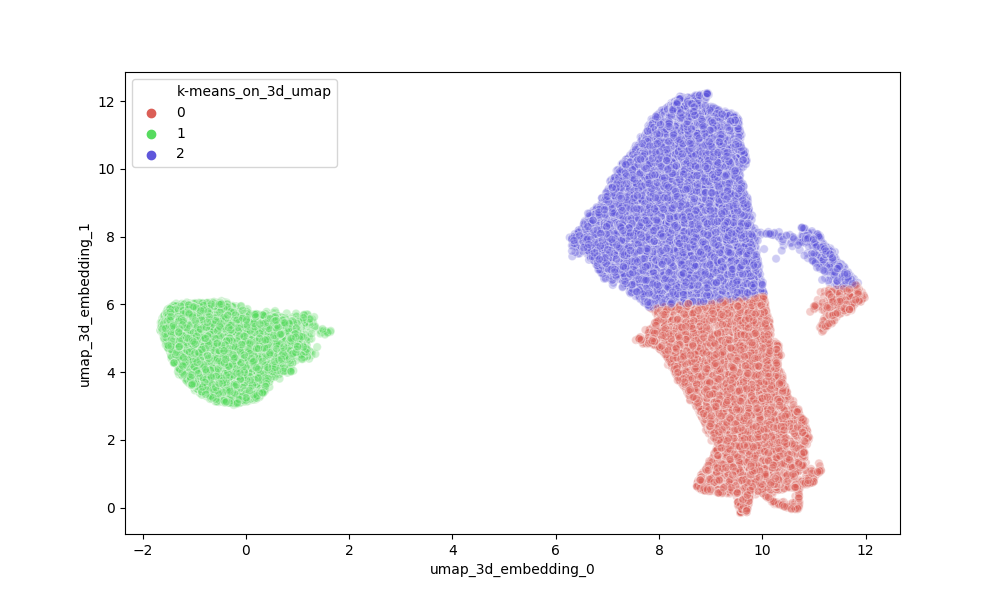

In [39]:
fig,ax=plt.subplots(1,1,figsize=(10,6),sharey=True,sharex=True)
sns.scatterplot(
    x='umap_3d_embedding_0', 
    y='umap_3d_embedding_1',
    hue='k-means_on_3d_umap',
    palette=sns.color_palette("hls", 3),
    data=rspm,
    legend='full',
    alpha=0.3,
    ax=ax,
)

### now make a 3d plotly plot of the same

In [40]:
import plotly.express as px
fig = px.scatter_3d(
    rspm, 
    x='umap_3d_embedding_0', 
    y='umap_3d_embedding_1', 
    z='umap_3d_embedding_2',
    color='k-means_on_3d_umap'
)
fig.show()

### plot the 2d umap results

<IPython.core.display.Javascript object>


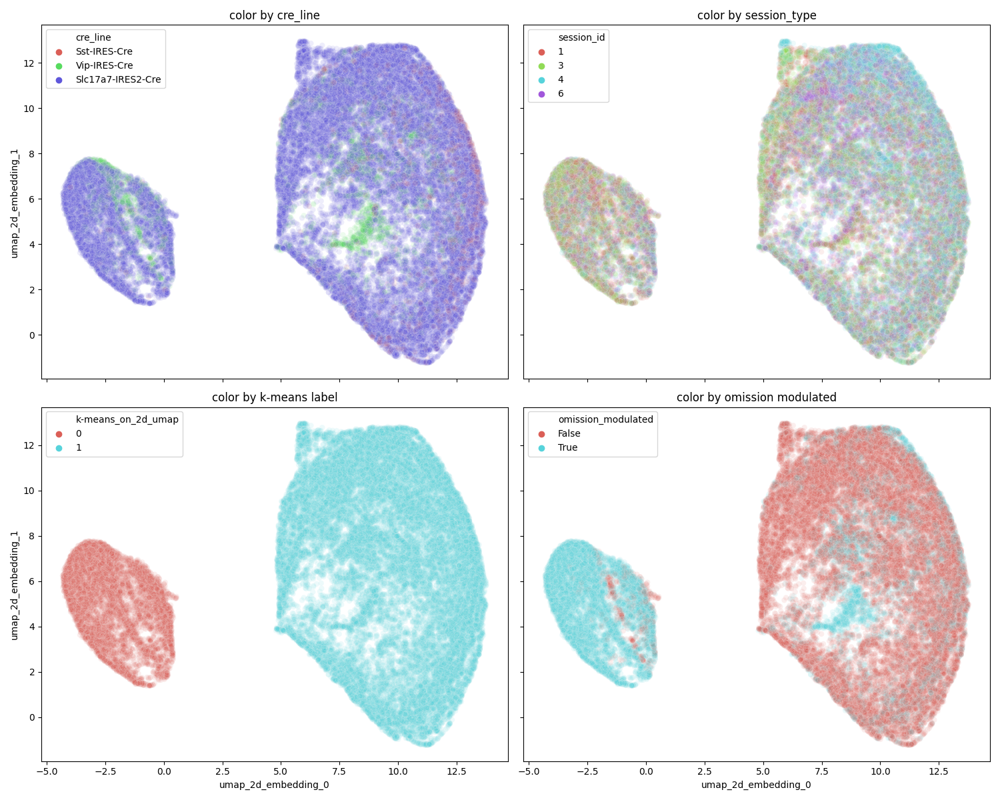

In [44]:
import seaborn as sns
fig,ax=plt.subplots(2,2,figsize=(15,12),sharey=True,sharex=True)
sns.scatterplot(
    x='umap_2d_embedding_0', 
    y='umap_2d_embedding_1',
    hue="cre_line",
    palette=sns.color_palette("hls", 3),
    data=rspm,
    legend="full",
    alpha=0.1,
    ax=ax[0,0]
)
sns.scatterplot(
    x='umap_2d_embedding_0', 
    y='umap_2d_embedding_1',
    hue="session_id",
    palette=sns.color_palette("hls", 4),
    data=rspm,
    legend="full",
    alpha=0.1,
    ax=ax[0,1]
)
sns.scatterplot(
    x='umap_2d_embedding_0', 
    y='umap_2d_embedding_1',
    hue='k-means_on_2d_umap',
    palette=sns.color_palette("hls", len(rspm['k-means_on_2d_umap'].unique())),
    data=rspm,
    legend="full",
    alpha=0.1,
    ax=ax[1,0]
)
sns.scatterplot(
    x='umap_2d_embedding_0', 
    y='umap_2d_embedding_1',
    hue='omission_modulated',
    palette=sns.color_palette("hls", 2),
    data=rspm,
    legend="full",
    alpha=0.1,
    ax=ax[1,1]
)
fig.tight_layout()
for ii,hue in enumerate(['cre_line','session_type','k-means label', 'omission modulated']):
    ax.flatten()[ii].set_title('color by {}'.format(hue))
fig.tight_layout()

### plot umap with omissions modulation as continuous color

<IPython.core.display.Javascript object>


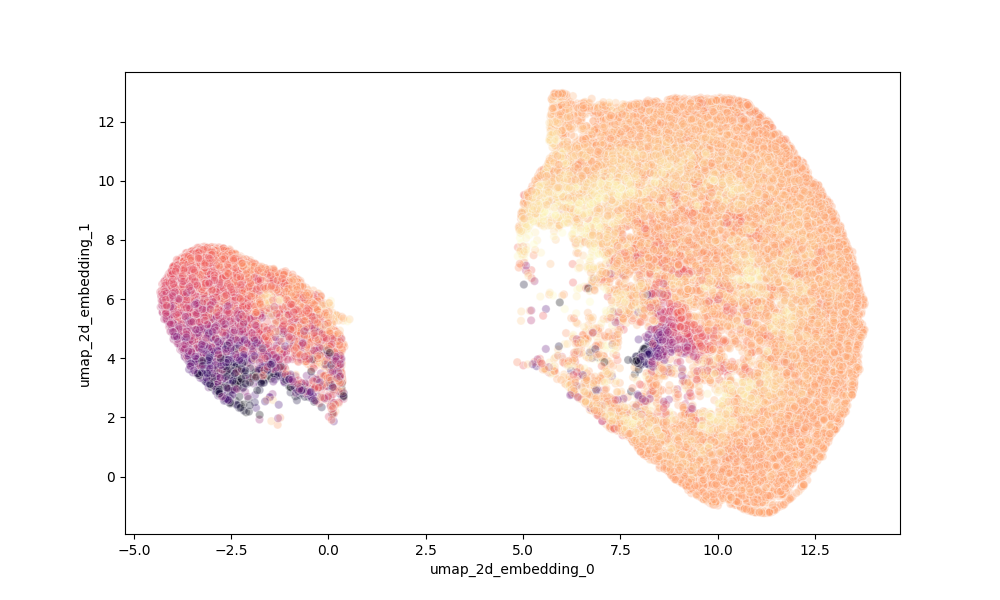

In [42]:
fig,ax=plt.subplots(1,1,figsize=(10,6),sharey=True,sharex=True)
sns.scatterplot(
    x='umap_2d_embedding_0', 
    y='umap_2d_embedding_1',
    hue='omissions',
    palette='magma',
    data=rspm.query('omissions>-1 and omissions<0.25'),
    legend=False,
    alpha=0.3,
    ax=ax,
)